In [1]:
from sklearn.metrics import classification_report, confusion_matrix
from skimage.metrics import structural_similarity as ssim
from sklearn import preprocessing
from keras.utils import to_categorical
from keras import regularizers
from keras.models import Model
from keras.callbacks import ModelCheckpoint
from keras.layers import Input, Dense, Dropout, Lambda, GlobalAveragePooling2D
from keras.src.legacy.preprocessing.image import ImageDataGenerator

import random
import re
import glob
from tqdm import tqdm
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
import time
import gc

2025-02-28 17:59:22.059934: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-02-28 17:59:22.158306: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-02-28 17:59:22.190429: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-02-28 17:59:22.992934: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: SSE4.1 SSE4.2 AVX AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
gpus = tf.config.list_physical_devices('GPU')
if gpus:
    print(f"GPUs disponíveis: {gpus}")
else:
    print("Nenhuma GPU encontrada.")

GPUs disponíveis: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


I0000 00:00:1740776385.925947     862 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1740776387.814184     862 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1740776387.814336     862 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.


In [3]:
# nome = 'PACS'
nome = 'Yildirim'
#nome = 'Todos'

imgs_path = 'Bases/Dataset' + nome

TEST_SIZE = 0.1
VALIDATION_SIZE = 0.1

SIMILARITY = 0.75

EPOCHS = 100
BATCH_SIZE = 32

HIGH_FREQ_THRESHOLD = 50

NOISE_FRACTION = 1.00
NOISE_LEVEL = 0.05

# NOISE_FRACTION = 0.50
# NOISE_LEVEL = 0.50

In [4]:
def get_next_filename(output_folder, base_name, type):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
        
    image_index = 0
    
    while True:
        output_filename = f"{base_name}_{image_index}.{type}"
        output_path = os.path.join(output_folder, output_filename)
        
        if not os.path.exists(output_path):
            return output_filename
            
        image_index += 1

In [5]:
def extract_number(filename):
    match = re.search(r'(\d+)', filename)
    return int(match.group(0)) if match else 0

In [6]:
def sort_files_numerically(file_paths):
    return sorted(file_paths, key=lambda x: extract_number(x))

In [7]:
def find_groups(images, image_paths, test_size, similarity_threshold):
    def are_similar(img1, img2, threshold):
        similarity = ssim(img1, img2)
        return similarity >= threshold

    groups = []
    current_group = [image_paths[0]]

    for i in range(1, len(images)):
        if are_similar(images[i-1], images[i], similarity_threshold):
            current_group.append(image_paths[i])
        else:
            groups.append(current_group)
            current_group = [image_paths[i]]
    
    if current_group:
        groups.append(current_group)

    all_images = [img_path for group in groups for img_path in group]

    for img_path in image_paths:
        if img_path not in all_images:
            groups.append([img_path])

    random.shuffle(groups)

    train_set = []
    test_set = []
    current_test_size = 0
    
    for i, group in enumerate(groups):
        if current_test_size + len(group) <= test_size:
            test_set.extend(group)
            current_test_size += len(group)
        else:
            train_set.extend(group)

    return train_set, test_set

In [8]:
output_folder = 'Groups'
type = 'txt'

def save_groups(train_groups, test_groups, base_name):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    output_filename = get_next_filename(output_folder, base_name, type)
    output_path = os.path.join(output_folder, output_filename)

    with open(output_path, 'w') as file:
        file.write('- test:\n')
        for idx, group in enumerate(test_groups, start=1):
            for img in group:
                file.write(f"{img}\n")
        
        file.write('- train:\n')
        for idx, group in enumerate(train_groups, start=1):
            for img in group:
                file.write(f'{img}\n')
    
    print(f'Group information saved in {output_path}')

In [9]:
def read_dataset(path, jpg, png):
    print(f'Reading dataset...\n')
    
    img_type = []
    images = []
    image_paths = []

    if jpg:
        img_type.append('*.jpg')
    if png:
        img_type.append('*.png')

# Normal
    
    normal_path = os.path.join(path, 'Train', 'Normal')
    normal_images = []
    normal_image_paths = []
    print(f'Reading Normal images from: {normal_path}')
    
    for img_type_pattern in img_type:
        img_paths = glob.glob(os.path.join(normal_path, img_type_pattern))
        img_paths = sort_files_numerically(img_paths)

        for img_path in img_paths:
            img = cv2.imread(img_path, 0)
            img = cv2.resize(img, (224, 224))
            normal_images.append(img)
            normal_image_paths.append(img_path)

    normal_images = np.array(normal_images)
    normal_image_paths = np.array(normal_image_paths)

# Normal Groups

    normal_total_images = len(normal_images)
    normal_test_size = int(normal_total_images * TEST_SIZE)

    print(f'Total number of normal images: {normal_total_images}')
    print(f'Calculated normal test size: {normal_test_size}')

    normal_train_set, normal_test_set = find_groups(normal_images, normal_image_paths, normal_test_size, SIMILARITY)

    print(f'Number of normal images in train set: {len(normal_train_set)}')
    print(f'Number of normal images in test set: {len(normal_test_set)}\n')

# Kidney
    
    kidney_stone_path = os.path.join(path, 'Train', 'Kidney_stone')
    kidney_stone_images = []
    kidney_stone_image_paths = []
    print(f'Reading Kidney_stone images from: {kidney_stone_path}')
    
    for img_type_pattern in img_type:
        img_paths = glob.glob(os.path.join(kidney_stone_path, img_type_pattern))
        img_paths = sort_files_numerically(img_paths)

        for img_path in img_paths:
            img = cv2.imread(img_path, 0)
            img = cv2.resize(img, (224, 224))
            kidney_stone_images.append(img)
            kidney_stone_image_paths.append(img_path)

    kidney_stone_images = np.array(kidney_stone_images)
    kidney_stone_image_paths = np.array(kidney_stone_image_paths)

# Kidney Groups
    
    kidney_stone_total_images = len(kidney_stone_images)
    kidney_stone_test_size = int(kidney_stone_total_images * TEST_SIZE)

    print(f'Total number of kidney images: {kidney_stone_total_images}')
    print(f'Calculated kidney test size: {kidney_stone_test_size}')

    kidney_stone_train_set, kidney_stone_test_set = find_groups(kidney_stone_images, kidney_stone_image_paths, kidney_stone_test_size, SIMILARITY)
    
    train_groups = [normal_train_set, kidney_stone_train_set]
    test_groups = [normal_test_set, kidney_stone_test_set]
    
    output_folder = 'Groups'
    base_name = 'groups_' + nome
    save_groups(train_groups, test_groups, base_name)

    print(f'Number of kidney images in train set: {len(kidney_stone_train_set)}')
    print(f'Number of kidney images in test set: {len(kidney_stone_test_set)}')

# ...
    
    X_train = []
    X_test = []

    for img_path in normal_train_set:
        idx = np.where(normal_image_paths == img_path)[0][0]
        X_train.append(normal_images[idx])

    for img_path in normal_test_set:
        idx = np.where(normal_image_paths == img_path)[0][0]
        X_test.append(normal_images[idx])

    for img_path in kidney_stone_train_set:
        idx = np.where(kidney_stone_image_paths == img_path)[0][0]
        X_train.append(kidney_stone_images[idx])

    for img_path in kidney_stone_test_set:
        idx = np.where(kidney_stone_image_paths == img_path)[0][0]
        X_test.append(kidney_stone_images[idx])

    X_train = np.array(X_train)
    X_test = np.array(X_test)

    return X_train, X_test

In [10]:
X_train, X_test = read_dataset(path=imgs_path, jpg=True, png=True)

Reading dataset...

Reading Normal images from: Bases/DatasetYildirim/Train/Normal
Total number of normal images: 1009
Calculated normal test size: 100
Number of normal images in train set: 909
Number of normal images in test set: 100

Reading Kidney_stone images from: Bases/DatasetYildirim/Train/Kidney_stone
Total number of kidney images: 790
Calculated kidney test size: 79
Group information saved in Groups/groups_Yildirim_13.txt
Number of kidney images in train set: 711
Number of kidney images in test set: 79


In [11]:
X_train_orig = X_train.copy()
X_test_orig = X_test.copy()

In [12]:
def high_freq_spec(image, threshold):
# Transformada de Fourier
    f = np.fft.fft2(image)
    fshift = np.fft.fftshift(f)
    
# Altas frequências
    rows, cols = image.shape
    crow, ccol = rows//2, cols//2
    mask_high = np.ones((rows, cols), np.uint8)
    mask_high[crow-threshold:crow+threshold, ccol-threshold:ccol+threshold] = 0  # Remove as baixas frequências
    
# Espectro
    fshift_high = fshift * mask_high
    magnitude_spectrum_high = 20 * np.log(np.abs(fshift_high) + 1)
    
    return magnitude_spectrum_high

In [13]:
def save_specs(images, threshold):
    specs = []
    for img in images:
        specs.append(high_freq_spec(img, threshold))
    return specs

In [14]:
len_normal_train_specs = int(len(X_train_orig) / 2)
len_normal_test_specs = int(len(X_test_orig) / 2)

In [15]:
normal_train_specs = X_train_orig[0:len_normal_train_specs]
normal_test_specs = X_test_orig[0:len_normal_test_specs]

In [16]:
normal_train_specs = save_specs(normal_train_specs, HIGH_FREQ_THRESHOLD)
normal_test_specs = save_specs(normal_test_specs, HIGH_FREQ_THRESHOLD)

In [17]:
print(len(normal_train_specs))
print(len(normal_test_specs))

810
89


In [18]:
hacked_train_specs = X_train_orig[len_normal_train_specs:len(X_train_orig)]
hacked_test_specs = X_test_orig[len_normal_test_specs:len(X_test_orig)]

In [19]:
hacked_train_specs = save_specs(hacked_train_specs, HIGH_FREQ_THRESHOLD)
hacked_test_specs = save_specs(hacked_test_specs, HIGH_FREQ_THRESHOLD)

In [20]:
print(len(hacked_train_specs))
print(len(hacked_test_specs))

810
90


In [21]:
def plot_specs(specs, title):
    total_images = len(specs)
    imgs_per_figure = 100
    cols = 5
    rows = (imgs_per_figure + cols - 1) // cols

    for start in range(0, total_images, imgs_per_figure):
        plt.figure(figsize=(cols * 3, rows * 3))
        end = min(start + imgs_per_figure, total_images)
        
        for i in range(start, end):
            # Espectro de Altas Frequências
            plt.subplot(rows, cols, i - start + 1)
            plt.imshow(specs[i], cmap='gray')
            plt.title(f"{title} - high freq spec: img {i+1}")
            plt.axis('off')
            
        plt.tight_layout()
        plt.show()

In [22]:
# Plotar todos os espectros de treino
#plot_specs(normal_train_specs, title="train")

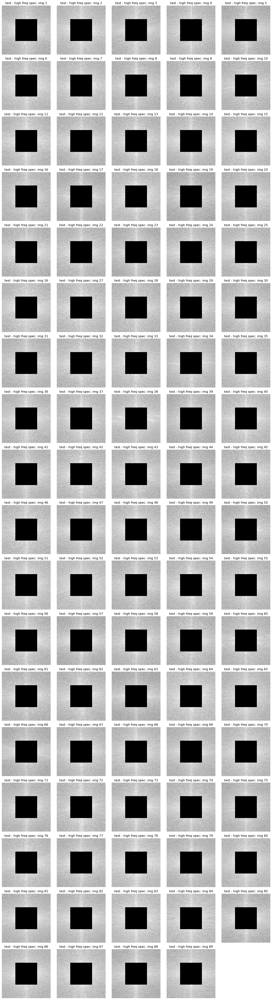

In [23]:
# Plotar todos os espectros de teste
plot_specs(normal_test_specs, title="test")

In [24]:
#pausa de teste

In [25]:
# SIMULAÇÃO DE RUÍDO

# Ruído Glaussiano
def add_high_freq_noise(image, threshold, noise_level, noise_fraction):
# Transformada de Fourier
    f = np.fft.fft2(image)
    fshift = np.fft.fftshift(f)
    
# Criar máscara de altas frequências
    rows, cols = image.shape
    crow, ccol = rows//2, cols//2
    mask_high = np.ones((rows, cols), dtype=bool)
    mask_high[crow-threshold:crow+threshold, ccol-threshold:ccol+threshold] = False
    
# Selecionar 5% das coordenadas nas altas frequências
    high_freq_coords = np.where(mask_high)
    num_pixels = int(noise_fraction * rows * cols)
    
    if len(high_freq_coords[0]) == 0 or num_pixels == 0:
        return image
    
# Garantir que não exceda o número de pixels disponíveis
    num_samples = min(num_pixels, len(high_freq_coords[0]))
    indices = np.random.choice(len(high_freq_coords[0]), num_samples, replace=False)
    selected_coords = (high_freq_coords[0][indices], high_freq_coords[1][indices])
    
# Gerar ruído complexo
    sigma = noise_level * 255
    noise = np.random.normal(0, sigma, selected_coords[0].size) + 1j * np.random.normal(0, sigma, selected_coords[0].size)
    
# Aplicar ruído nas frequências selecionadas
    fshift[selected_coords] += noise
    
# Transformada inversa
    f_ishift = np.fft.ifftshift(fshift)
    img_back = np.fft.ifft2(f_ishift)
    img_back = np.abs(img_back).clip(0, 255).astype(np.uint8)
    
    return img_back

def add_high_freq_noise_to_images(images, threshold, noise_level, noise_fraction):
    return [add_high_freq_noise(img, threshold, noise_level, noise_fraction) for img in images]

hacked_train_specs = add_high_freq_noise_to_images(hacked_train_specs, HIGH_FREQ_THRESHOLD, NOISE_LEVEL, NOISE_FRACTION)
hacked_test_specs = add_high_freq_noise_to_images(hacked_test_specs, HIGH_FREQ_THRESHOLD, NOISE_LEVEL, NOISE_FRACTION)

# Labels:
normal_train_labels = np.zeros(len(normal_train_specs), dtype=bool)
hacked_train_labels = np.ones(len(hacked_train_specs), dtype=bool)

normal_test_labels = np.zeros(len(normal_test_specs), dtype=bool)
hacked_test_labels = np.ones(len(hacked_test_specs), dtype=bool)

# Combina os espectros
all_train_specs = np.concatenate((normal_train_specs, hacked_train_specs), axis=0)
all_train_labels = np.concatenate((normal_train_labels, hacked_train_labels))

all_test_specs = np.concatenate((normal_test_specs, hacked_test_specs), axis=0)
all_test_labels = np.concatenate((normal_test_labels, hacked_test_labels))

print("Tamanho do conjunto de treino:", all_train_specs.shape)
print("Tamanho do conjunto de teste:", all_test_specs.shape)
print("Exemplo dos labels de treino (False = original, True = com ruído):", all_train_labels)

Tamanho do conjunto de treino: (1620, 224, 224)
Tamanho do conjunto de teste: (179, 224, 224)
Exemplo dos labels de treino (False = original, True = com ruído): [False False False ...  True  True  True]


In [26]:
# Plotar todos os espectros de treino com ruído
#plot_specs(hacked_train_specs, title="train *")

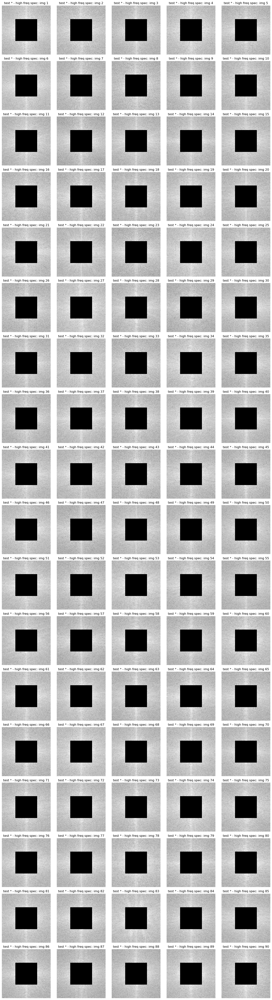

In [27]:
# Plotar todos os espectros de teste com ruído
plot_specs(hacked_test_specs, title="test *")

In [28]:
#pausa de teste

In [29]:
# Pré-processamento dos dados: adiciona dimensão do canal
all_train_specs = np.expand_dims(all_train_specs, axis=-1)
all_test_specs = np.expand_dims(all_test_specs, axis=-1)

# Converte os labels para o formato one-hot
all_train_labels_cat = to_categorical(all_train_labels.astype(int), num_classes=2)
all_test_labels_cat = to_categorical(all_test_labels.astype(int), num_classes=2)

In [30]:
# Defines the model layers
def model_resnet152():
    # Camada de entrada para imagens em escala de cinza
    inputs = Input(shape=(224, 224, 1))
    
    # 1. Converter imagem para 3 canais (replicando o canal único)
    x = Lambda(lambda x: tf.repeat(x, 3, axis=-1))(inputs)
    
    # 2. Pré-processamento específico para ResNet
    x = tf.keras.applications.resnet.preprocess_input(x)
    
    # 3. Carregar ResNet-152 sem o topo (include_top=False)
    base_model = tf.keras.applications.ResNet152(
        weights='imagenet',  # Usar pesos pré-treinados
        include_top=False,   # Remover camadas fully-connected
        input_tensor=x
    )
    
    # 4. Adicionar novas camadas no topo
    x = base_model.output
    x = GlobalAveragePooling2D()(x)  # Melhor que Flatten para redes grandes
    
    # Camadas densas personalizadas (mantendo sua estrutura original)
    x = Dense(150, kernel_regularizer=regularizers.l2(0.01), activation='relu')(x)
    x = Dropout(0.25)(x)
    
    x = Dense(100, kernel_regularizer=regularizers.l2(0.01), activation='relu')(x)
    x = Dropout(0.25)(x)
    
    outputs = Dense(2, activation='softmax')(x)
    
    # Criar e compilar modelo
    model = Model(inputs=inputs, outputs=outputs)
    model.compile(
        optimizer='Adam',
        loss='categorical_crossentropy',
        metrics=['accuracy']
    )
    
    return model

In [31]:
# Create model
model = model_resnet152()

I0000 00:00:1740776456.149755     862 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1740776456.149861     862 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1740776456.149922     862 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1740776456.467610     862 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1740776456.467797     862 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
2025-02-28

In [32]:
# Print the model summary
model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lambda (Lambda)     │ (None, 224, 224,  │          0 │ input_layer[0][0] │
│                     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item (GetItem)  │ (None, 224, 224)  │          0 │ lambda[0][0]      │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item_1          │ (None, 224, 224)  │          0 │ lambda[0][0]      │
│ (GetItem)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item_2          │ (None, 224, 224)  │          0 │ lambda[0][0]      │
│ (GetItem)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stack (Stack)       │ (None, 224, 224,  │          0 │ get_item[0][0],   │
│                     │ 3)                │            │ get_item_1[0][0], │
│                     │                   │            │ get_item_2[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, 224, 224,  │          0 │ stack[0][0]       │
│                     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 230, 230,  │          0 │ add[0][0]         │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 112, 112,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 112, 112,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 114, 114,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 56, 56,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │     36,928 │ conv2_block1_1_r

 Total params: 58,693,596 (223.90 MB)

 Trainable params: 58,542,172 (223.32 MB)

 Non-trainable params: 151,424 (591.50 KB)

In [33]:
# Defines local to save the model results
output_folder = 'Models_saves'
base_name = 'model_' + nome
type = 'keras'

model_filepath = os.path.join(output_folder, get_next_filename(output_folder, base_name, type))
checkpoint = ModelCheckpoint(filepath=model_filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')

In [34]:
start_time = time.time()

In [35]:
# Train the model
history = model.fit(
    all_train_specs, all_train_labels_cat,
    batch_size=BATCH_SIZE,
    epochs=EPOCHS,
    validation_data=(all_test_specs, all_test_labels_cat),
    steps_per_epoch=len(all_train_specs) // BATCH_SIZE,
    callbacks=[checkpoint],
    verbose=1
)

Epoch 1/100


I0000 00:00:1740776521.603790     935 service.cc:146] XLA service 0x7fb5ac003c20 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1740776521.603919     935 service.cc:154]   StreamExecutor device (0): NVIDIA GeForce RTX 3060, Compute Capability 8.6
2025-02-28 18:02:03.777593: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2025-02-28 18:02:10.350452: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:531] Loaded cuDNN version 90101
2025-02-28 18:02:19.041660: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:393] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_45147', 196 bytes spill stores, 196 bytes spill loads

2025-02-28 18:03:00.835844: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:393] ptxas warning : Registers are spilled to local memory in fu

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step - accuracy: 0.4874 - loss: 4.2147

2025-02-28 18:03:27.563923: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:393] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_4956', 208 bytes spill stores, 208 bytes spill loads




Epoch 1: val_accuracy improved from -inf to 0.50279, saving model to Models_saves/model_Yildirim_7.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 170s 1s/step - accuracy: 0.4876 - loss: 4.2010 - val_accuracy: 0.5028 - val_loss: 3108512256.0000
Epoch 2/100


2025-02-28 18:04:16.823916: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:393] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_45147', 208 bytes spill stores, 208 bytes spill loads



 1/50 ━━━━━━━━━━━━━━━━━━━━ 42:34 52s/step - accuracy: 0.5000 - loss: 2.2376

2025-02-28 18:04:52.434674: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]
2025-02-28 18:04:52.434749: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
/home/user/miniconda3/envs/tf_gpu/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)



Epoch 2: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 55s 60ms/step - accuracy: 0.5000 - loss: 2.2376 - val_accuracy: 0.5028 - val_loss: 1938659584.0000
Epoch 3/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step - accuracy: 0.4899 - loss: 2.0156
Epoch 3: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 18s 365ms/step - accuracy: 0.4898 - loss: 2.0113 - val_accuracy: 0.5028 - val_loss: 1.4289
Epoch 4/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 12s 262ms/step - accuracy: 0.5500 - loss: 1.4204

2025-02-28 18:05:14.023486: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]



Epoch 4: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.5500 - loss: 1.4204 - val_accuracy: 0.5028 - val_loss: 1.4198
Epoch 5/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 413ms/step - accuracy: 0.5216 - loss: 1.3319
Epoch 5: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 21s 424ms/step - accuracy: 0.5214 - loss: 1.3304 - val_accuracy: 0.5028 - val_loss: 1.1212
Epoch 6/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 12s 251ms/step - accuracy: 0.2500 - loss: 1.1495
Epoch 6: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.2500 - loss: 1.1495 - val_accuracy: 0.5028 - val_loss: 1.1174
Epoch 7/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step - accuracy: 0.5415 - loss: 1.0763
Epoch 7: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 21s 428ms/step - accuracy: 0.5411 - loss: 1.0757 - val_accuracy: 0.5028 - val_loss: 0.9798
Epoch 8/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 12s 253ms/step - accuracy:

2025-02-28 18:05:58.245176: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]



Epoch 8: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.6000 - loss: 0.9595 - val_accuracy: 0.5028 - val_loss: 0.9777
Epoch 9/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step - accuracy: 0.5441 - loss: 0.9525
Epoch 9: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 18s 365ms/step - accuracy: 0.5442 - loss: 0.9522 - val_accuracy: 0.5028 - val_loss: 0.9054
Epoch 10/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 12s 250ms/step - accuracy: 0.5500 - loss: 0.8687
Epoch 10: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.5500 - loss: 0.8687 - val_accuracy: 0.5028 - val_loss: 0.9043
Epoch 11/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step - accuracy: 0.5960 - loss: 0.8730
Epoch 11: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 21s 424ms/step - accuracy: 0.5957 - loss: 0.8728 - val_accuracy: 0.4972 - val_loss: 9.0395
Epoch 12/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 12s 253ms/step - accu

2025-02-28 18:07:20.503007: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]



Epoch 16: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.4500 - loss: 0.8165 - val_accuracy: 0.5028 - val_loss: 1.5818
Epoch 17/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step - accuracy: 0.5211 - loss: 0.7966
Epoch 17: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 21s 424ms/step - accuracy: 0.5208 - loss: 0.7966 - val_accuracy: 0.4972 - val_loss: 831664.8125
Epoch 18/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 12s 252ms/step - accuracy: 0.4500 - loss: 0.7829
Epoch 18: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.4500 - loss: 0.7829 - val_accuracy: 0.4972 - val_loss: 773372.2500
Epoch 19/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step - accuracy: 0.5351 - loss: 0.7766
Epoch 19: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 18s 364ms/step - accuracy: 0.5352 - loss: 0.7765 - val_accuracy: 0.4972 - val_loss: 295.9169
Epoch 20/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 12s 25

2025-02-28 18:10:08.308759: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]



Epoch 32: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.5000 - loss: 0.7376 - val_accuracy: 0.4972 - val_loss: 0.7395
Epoch 33/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step - accuracy: 0.6872 - loss: 0.6361
Epoch 33: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 18s 364ms/step - accuracy: 0.6863 - loss: 0.6365 - val_accuracy: 0.4972 - val_loss: 0.7333
Epoch 34/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 12s 253ms/step - accuracy: 0.4500 - loss: 0.7659
Epoch 34: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.4500 - loss: 0.7659 - val_accuracy: 0.4972 - val_loss: 0.7406
Epoch 35/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step - accuracy: 0.5002 - loss: 0.7341
Epoch 35: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 21s 425ms/step - accuracy: 0.5001 - loss: 0.7340 - val_accuracy: 0.4972 - val_loss: 0.7202
Epoch 36/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 12s 253ms/step - a

2025-02-28 18:15:42.275983: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]



Epoch 64: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.4500 - loss: 0.6991 - val_accuracy: 0.5028 - val_loss: 0.6961
Epoch 65/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step - accuracy: 0.5031 - loss: 0.6955
Epoch 65: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 21s 423ms/step - accuracy: 0.5030 - loss: 0.6956 - val_accuracy: 0.4972 - val_loss: 0.6956
Epoch 66/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 12s 256ms/step - accuracy: 0.3000 - loss: 0.6987
Epoch 66: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.3000 - loss: 0.6987 - val_accuracy: 0.4972 - val_loss: 0.6956
Epoch 67/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step - accuracy: 0.5055 - loss: 0.6955
Epoch 67: val_accuracy did not improve from 0.50279
50/50 ━━━━━━━━━━━━━━━━━━━━ 18s 362ms/step - accuracy: 0.5053 - loss: 0.6955 - val_accuracy: 0.5028 - val_loss: 0.6953
Epoch 68/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 12s 252ms/step - a

In [36]:
end_time = time.time()

In [37]:
training_time = end_time - start_time

print(f"O modelo demorou {training_time:.2f} segundos para treinar.")

O modelo demorou 1352.42 segundos para treinar.


In [38]:
# Make predictions
predictions = model.predict(all_test_specs)
y_pred = np.argmax(predictions, axis=1)
y_true = np.argmax(all_test_labels_cat, axis=1)

6/6 ━━━━━━━━━━━━━━━━━━━━ 139s 11s/step


In [39]:
output_folder = 'Convergence_graphs'
type = 'png'

# Define the function to plot and save Convergence Graphs
def plot_and_save_graph(history):
    base_name = 'Graph_' + nome
    
    output_filename = get_next_filename(output_folder, base_name, type)
    output_path_png = os.path.join(output_folder, output_filename)
    
    output_base_name = output_filename.replace('.png', '')
    output_txt = os.path.join(output_folder, f'{output_base_name}.txt')

    fig, ax = plt.subplots(figsize=(6, 6))
    ax.plot(history.history['accuracy'])
    ax.plot(history.history['val_accuracy'])
    ax.set_title('Model accuracy')
    ax.set_ylabel('accuracy')
    ax.set_xlabel('epoch')
    ax.legend(['train', 'val'], loc='upper left')

    plt.savefig(output_path_png)

    plt.show()

    with open(output_txt, 'w') as f:
        f.write('Accuracy:\n')
        f.write(', '.join(map(str, history.history['accuracy'])) + '\n\n')
        f.write('Validation Accuracy:\n')
        f.write(', '.join(map(str, history.history['val_accuracy'])) + '\n')

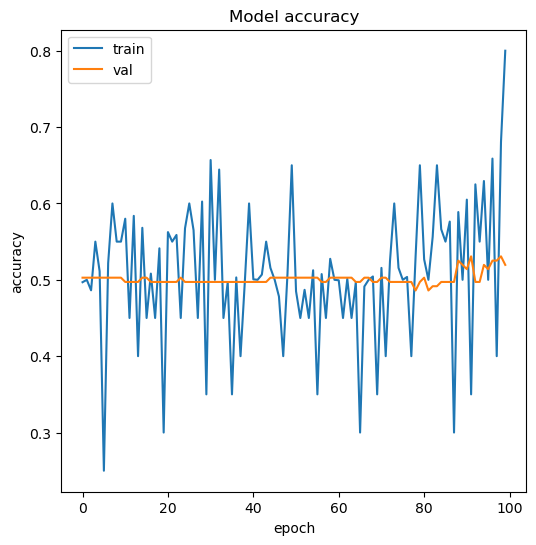

In [40]:
plot_and_save_graph(history)

In [41]:
cm_plot_labels = ['Normal', 'Hacked']

In [42]:
output_folder = 'Classification_report'
type = 'txt'

# Define the function to plot and save classification report
def plot_and_save_report(y_true, y_pred):
    base_name = 'report_' + nome

    output_filename = get_next_filename(output_folder, base_name, type)
    output_path = os.path.join(output_folder, output_filename)

    report = classification_report(y_true, y_pred, target_names=cm_plot_labels)
    print(report)

    with open(output_path, 'w') as f:
        f.write(report)

In [43]:
plot_and_save_report(y_true, y_pred)

              precision    recall  f1-score   support

      Normal       0.51      0.78      0.62        89
      Hacked       0.55      0.27      0.36        90

    accuracy                           0.52       179
   macro avg       0.53      0.52      0.49       179
weighted avg       0.53      0.52      0.49       179



In [44]:
output_folder = 'Confusion_matrix'
type = 'png'

# Define the flot confusion matrix
def plot_and_matrix(y_true, y_pred, cm_plot_labels):
    base_name = 'matrix_' + nome
    
    output_filename = get_next_filename(output_folder, base_name, type)
    output_path = os.path.join(output_folder, output_filename)

    cm = confusion_matrix(y_true=y_true, y_pred=y_pred)

    plt.figure(figsize=(6,6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.xticks(ticks=[0.5, 1.5], labels=cm_plot_labels)
    plt.yticks(ticks=[0.5, 1.5], labels=cm_plot_labels)
    
    plt.savefig(output_path)

    plt.show()

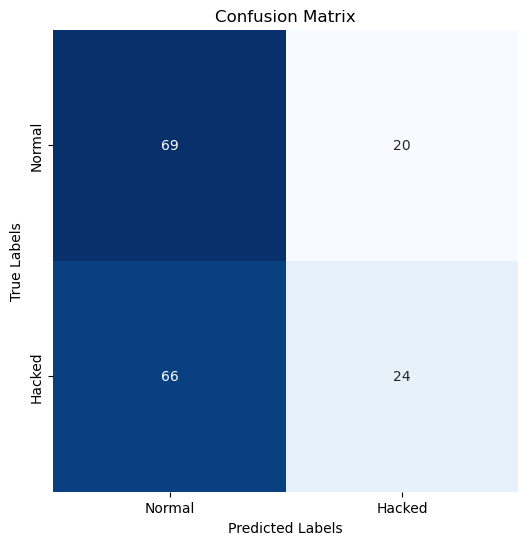

In [45]:
plot_and_matrix(y_true, y_pred, cm_plot_labels)

In [46]:
def plot_preds(X_test, y_true, y_pred):
    total_images = len(X_test)
    images_per_figure = 100
    cols = 5
    rows = (images_per_figure + cols - 1) // cols
    font_style = {'fontsize': 12, 'fontweight': 'bold'}

    for start in range(0, total_images, images_per_figure):
        plt.figure(figsize=(cols * 3, rows * 3))
        end = min(start + images_per_figure, total_images)

        for i in range(start, end):
            actual = 'Normal' if y_true[i] == 0 else 'Hacked'

            plt.subplot(rows, cols, i - start + 1)
            plt.title(f"Predict: {y_pred[i]} - {predictions[i][y_pred[i]] * 100:.2f}%\nActual: {y_true[i]} ({actual})", fontdict=font_style, color=('green' if y_pred[i] == y_true[i] else 'red'))
            plt.imshow(X_test[i], cmap='gray')
            plt.axis('off')

        plt.tight_layout()
        plt.show()

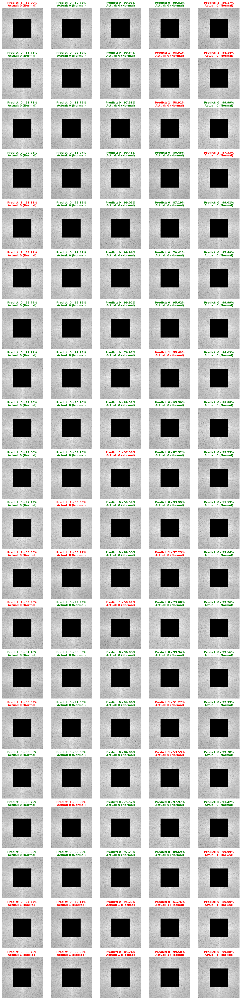

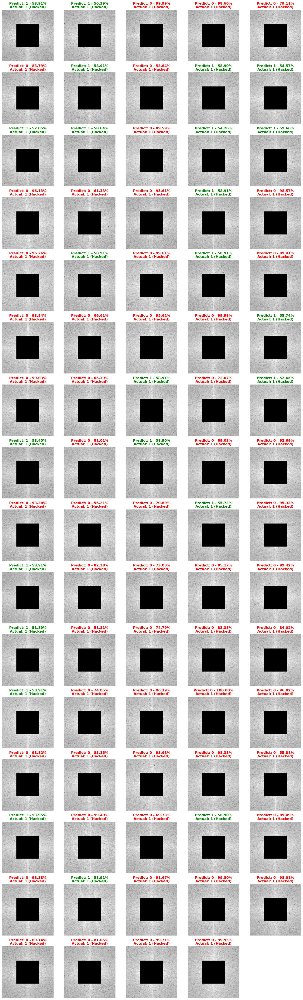

In [47]:
plot_preds(all_test_specs, y_true, y_pred)

In [48]:
# GC collect
gc.collect()

189489